
# **Neural Style Transfer with OpenCV**

####**In this lesson we'll learn how to use pre-trained Models to implement Neural Style Transfer in OpenCV**

![](https://github.com/rajeevratan84/ModernComputerVision/raw/main/NSTdemo.png)

**About Neural Style Transfers**

Introduced by Leon Gatys et al. in 2015, in their paper titled “[A Neural Algorithm for Artistic Style](https://arxiv.org/abs/1508.06576)”, the Neural Style Transfer algorithm went viral resulting in an explosion of further work and mobile apps.

Neural Style Transfer enables the artistic style of an image to be applied to another image! It copies the color patterns, combinations, and brush strokes of the original source image and applies it to your input image. And is one the most impressive implementations of Neural Networks in my opinion.

![](https://github.com/rajeevratan84/ModernComputerVision/raw/main/NST.png)


In [18]:
import numpy as np
import time
import cv2
import os
from os import listdir
from os.path import isfile, join
from matplotlib import pyplot as plt 

# Define our imshow function 
def imshow(title = "Image", image = None, size = 10):
    w, h = image.shape[0], image.shape[1]
    aspect_ratio = w/h
    plt.figure(figsize=(size * aspect_ratio,size))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.show()

1. Using Model: candy


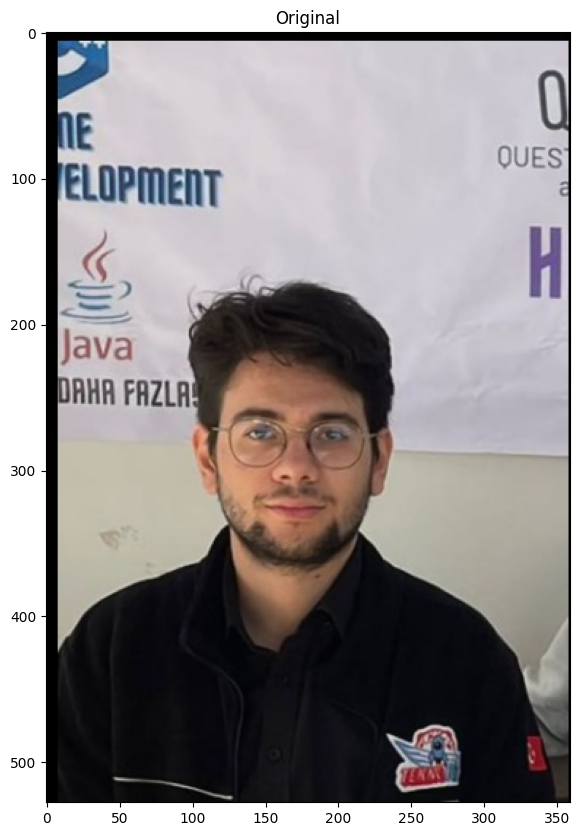

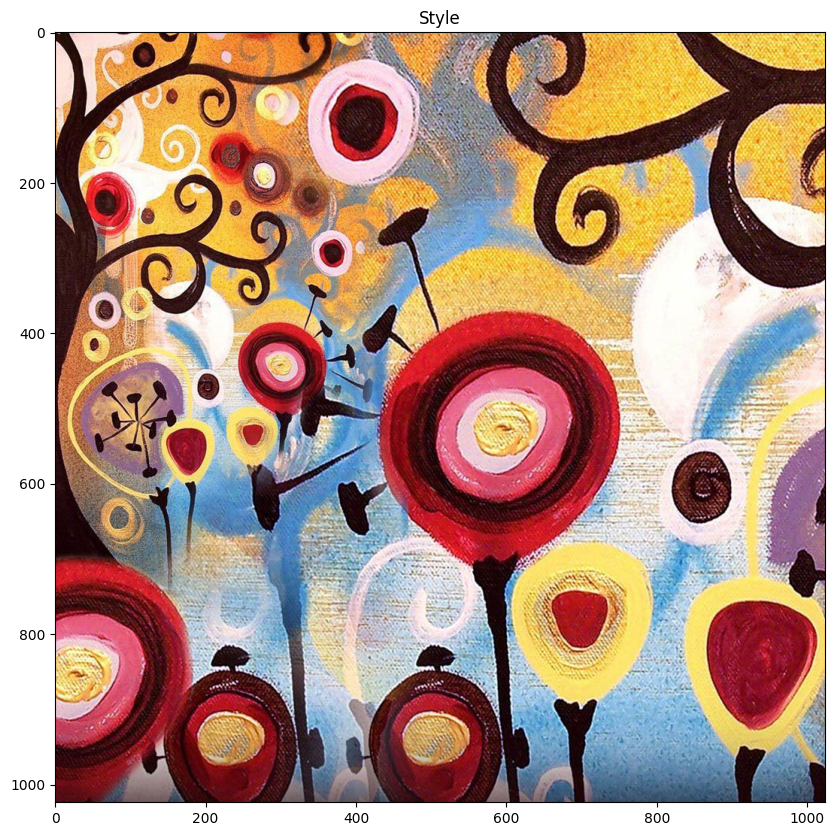

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


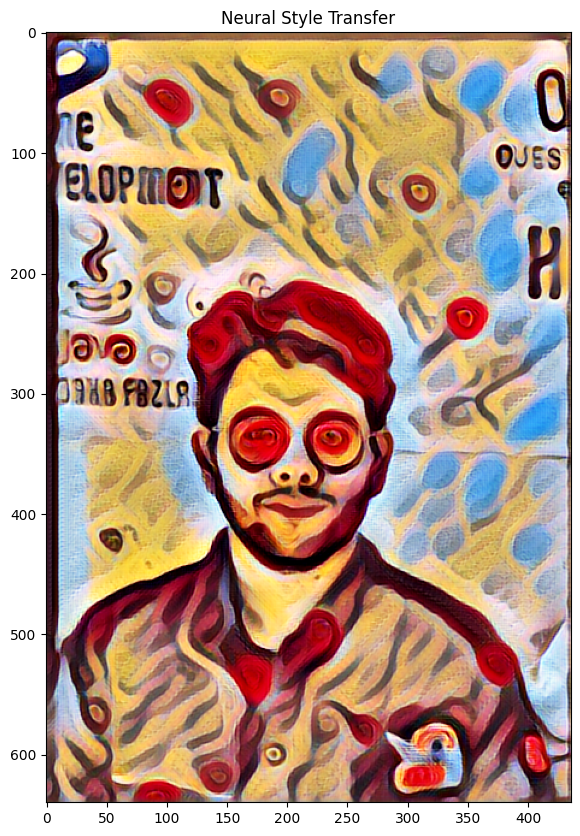

2. Using Model: composition_vii


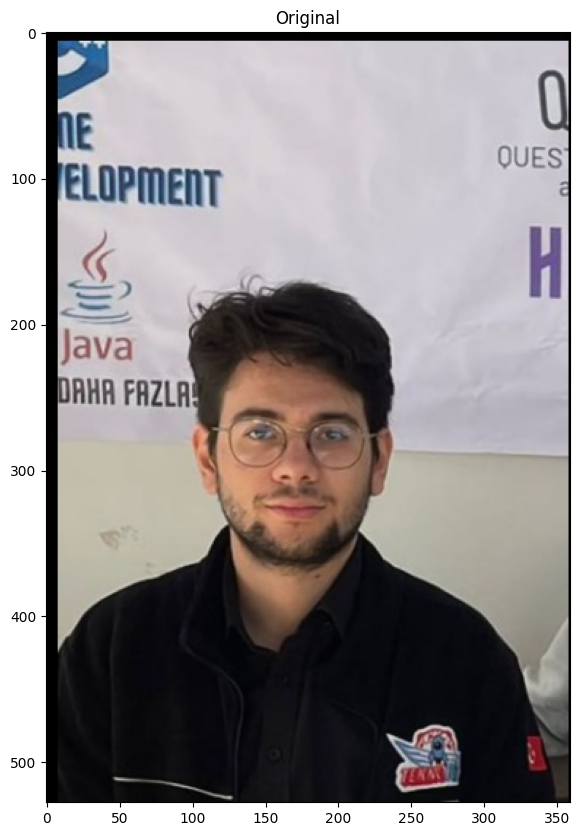

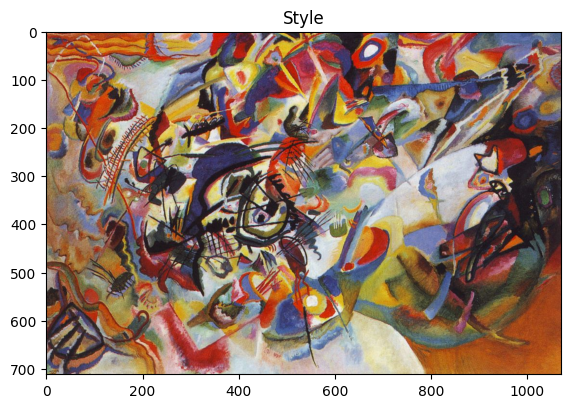

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


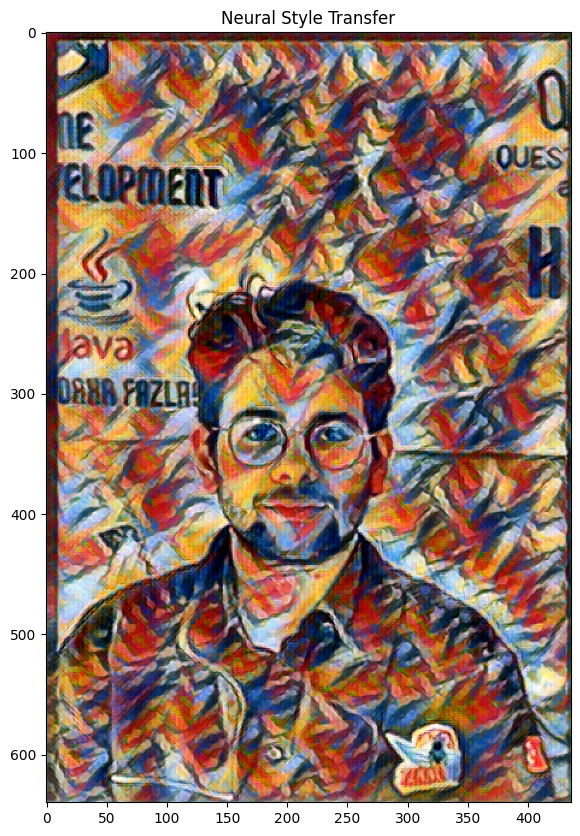

3. Using Model: feathers


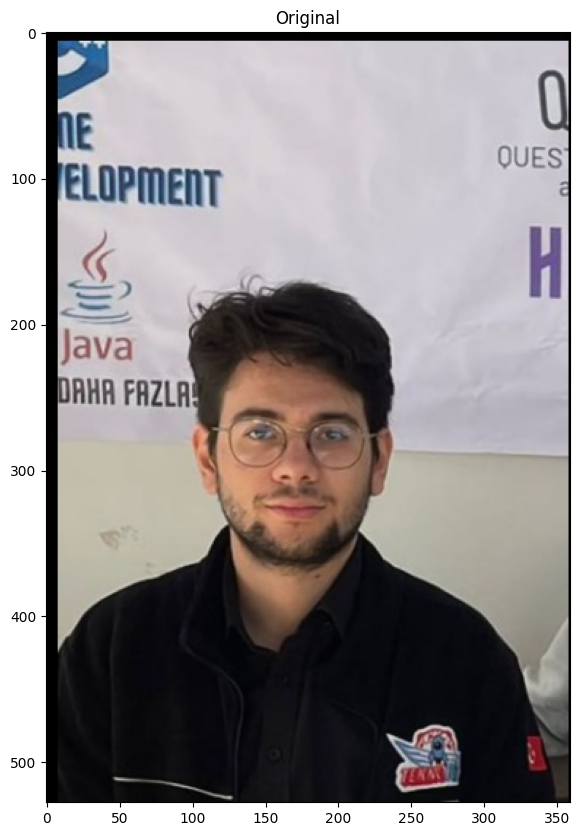

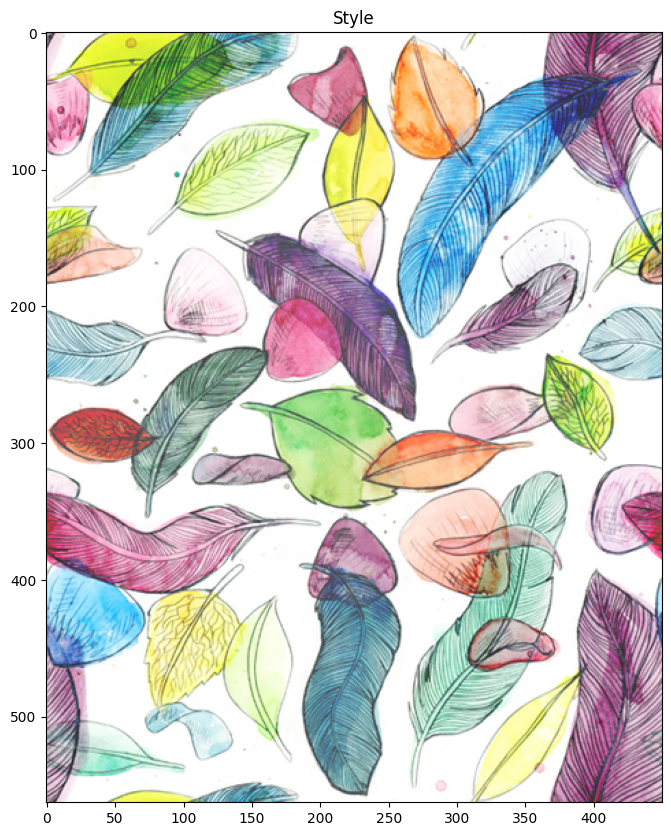

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


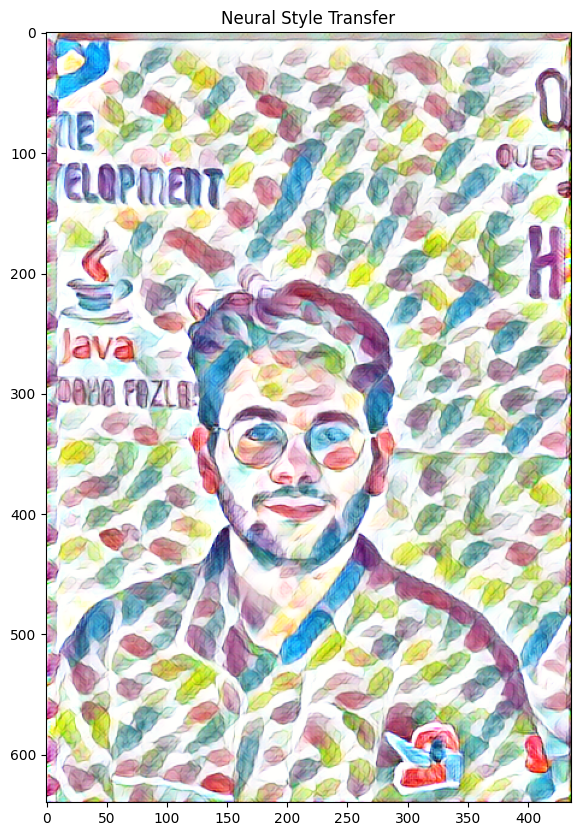

4. Using Model: la_muse


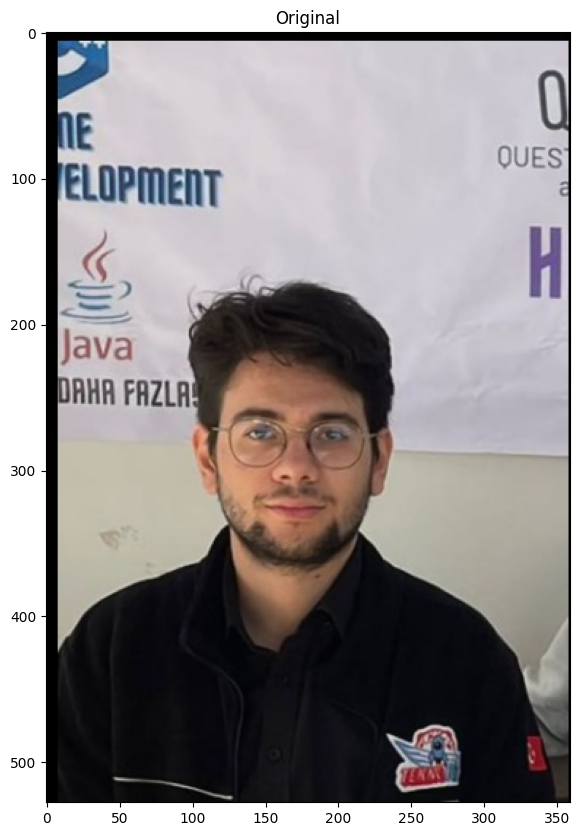

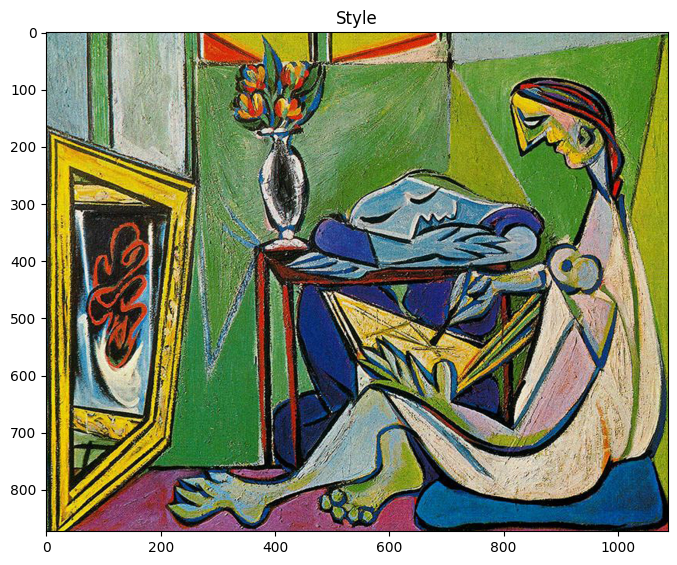

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


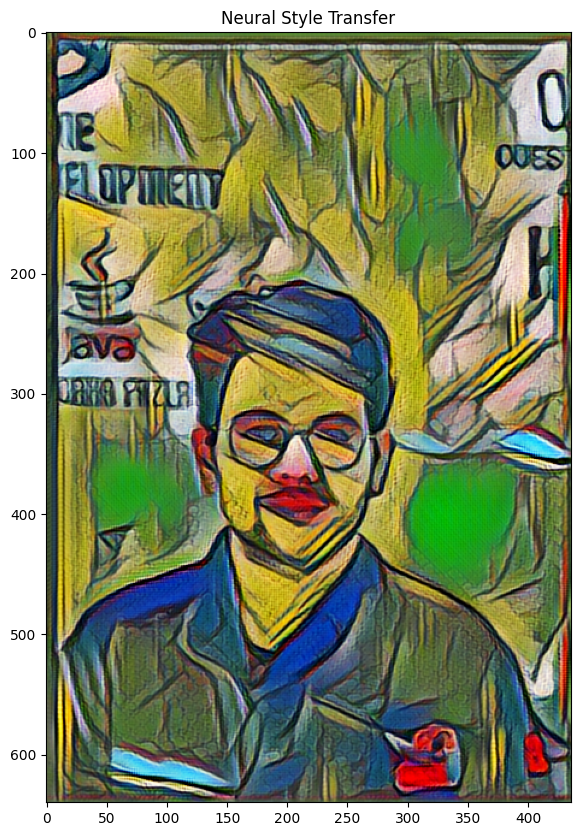

5. Using Model: mosaic


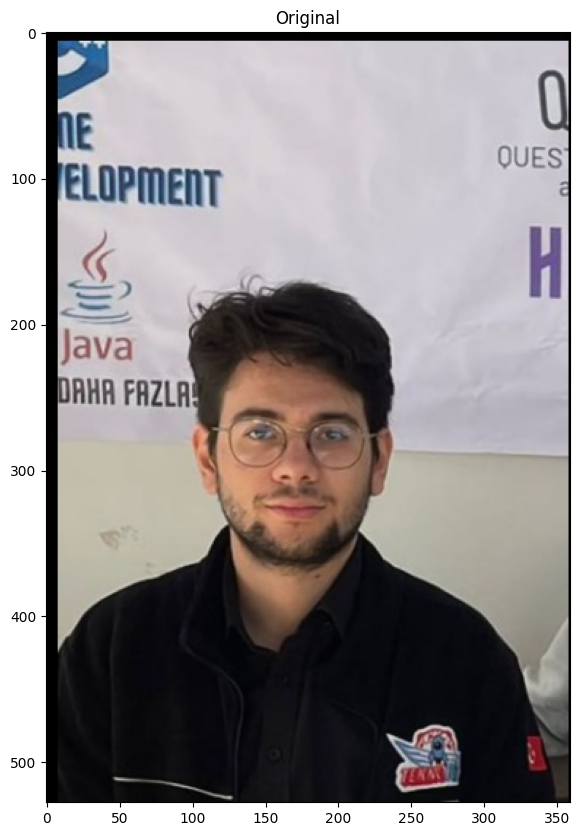

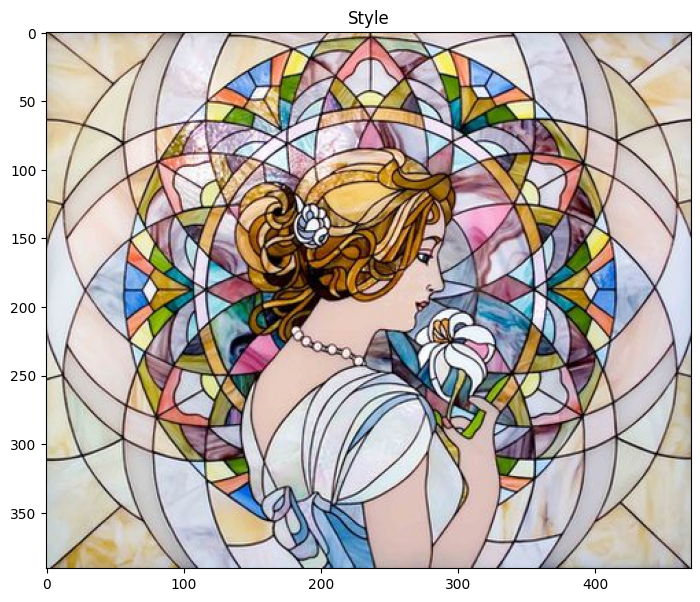

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


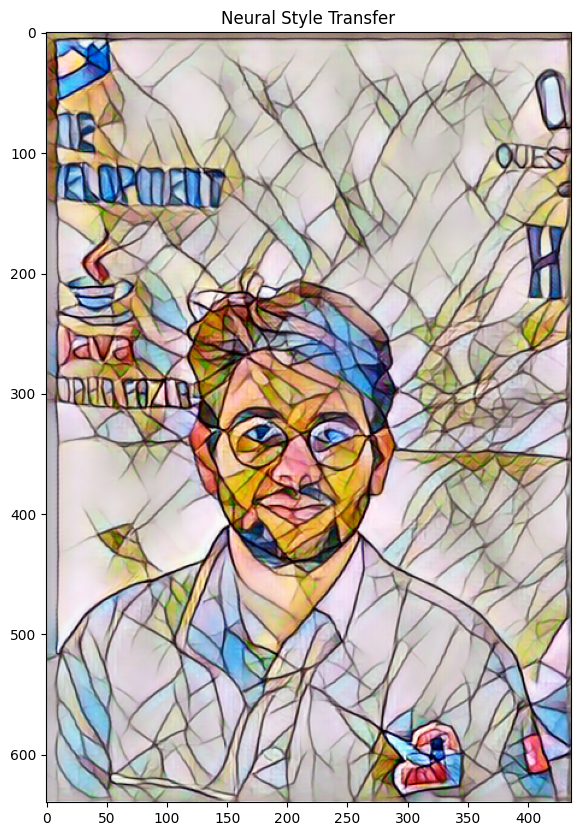

6. Using Model: starry_night


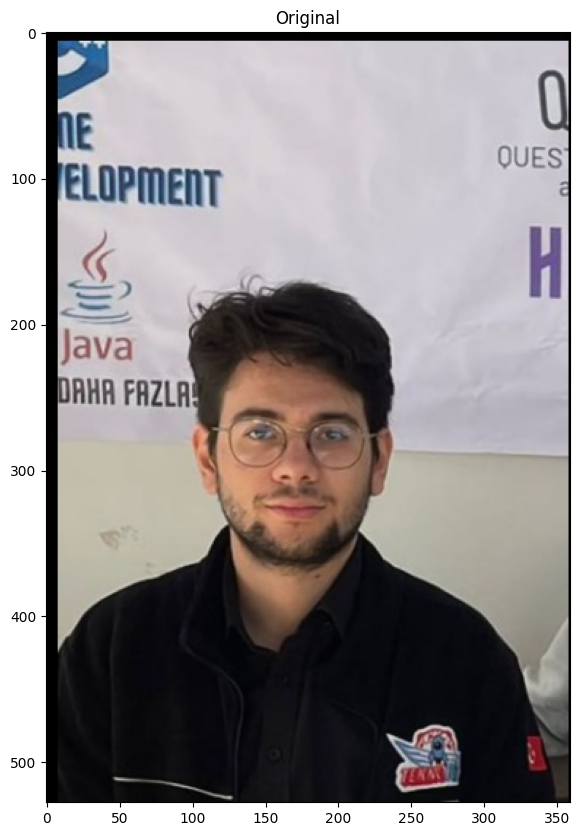

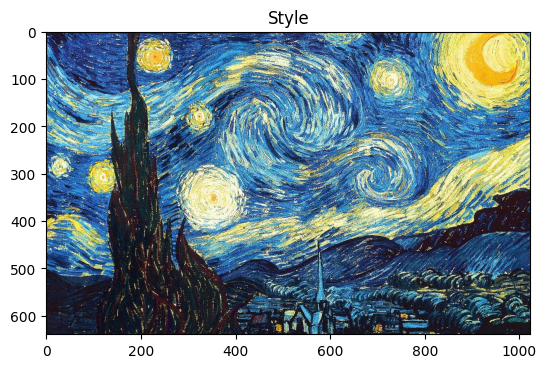

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


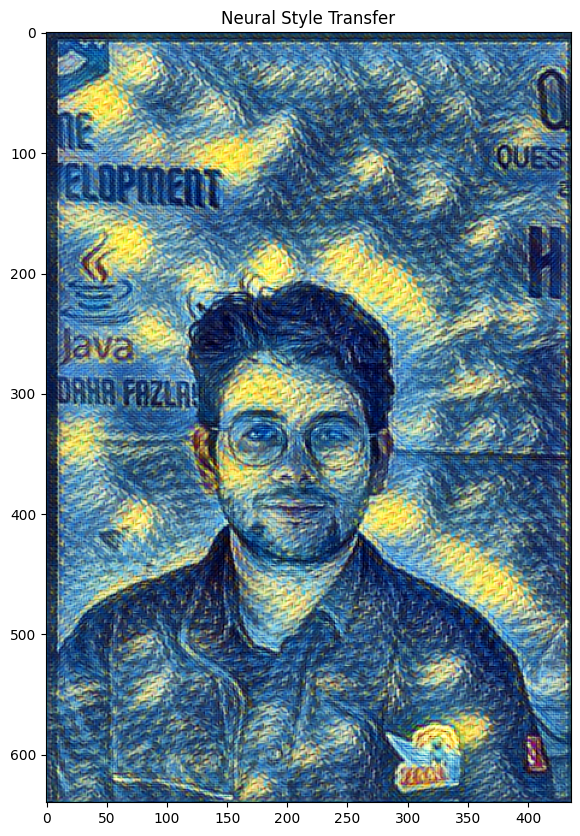

7. Using Model: the_scream


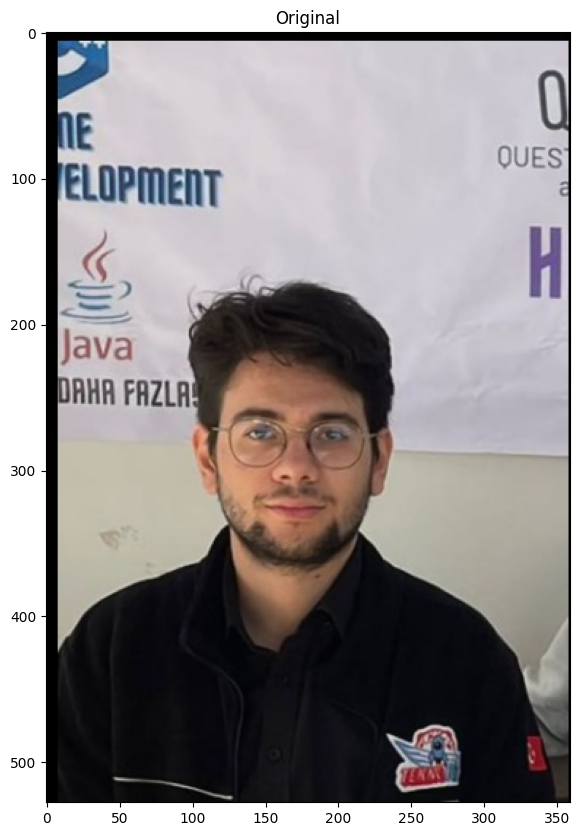

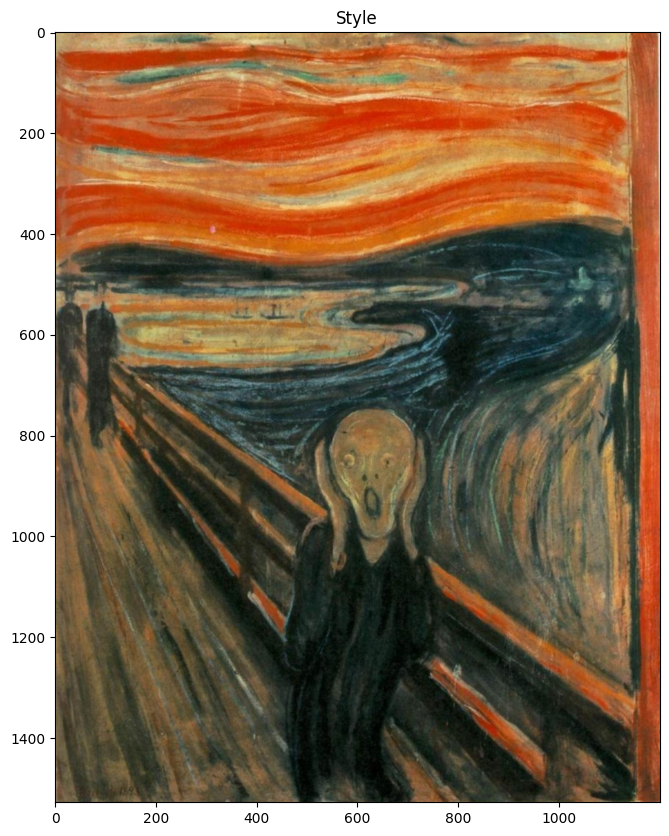

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


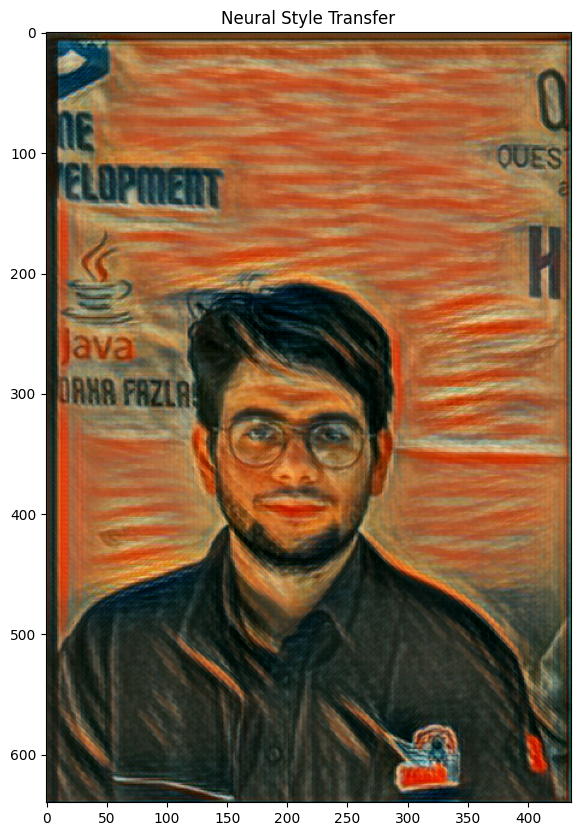

8. Using Model: the_wave


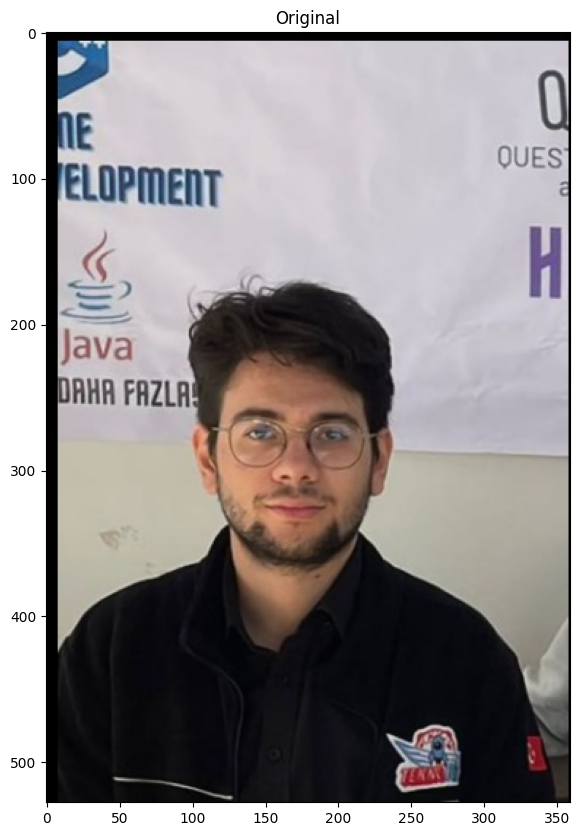

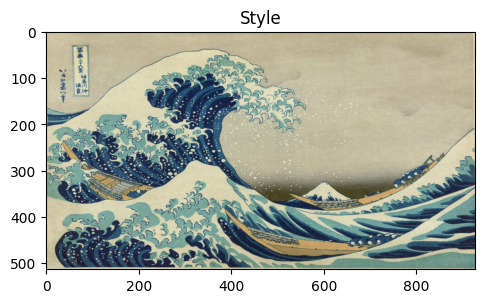

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


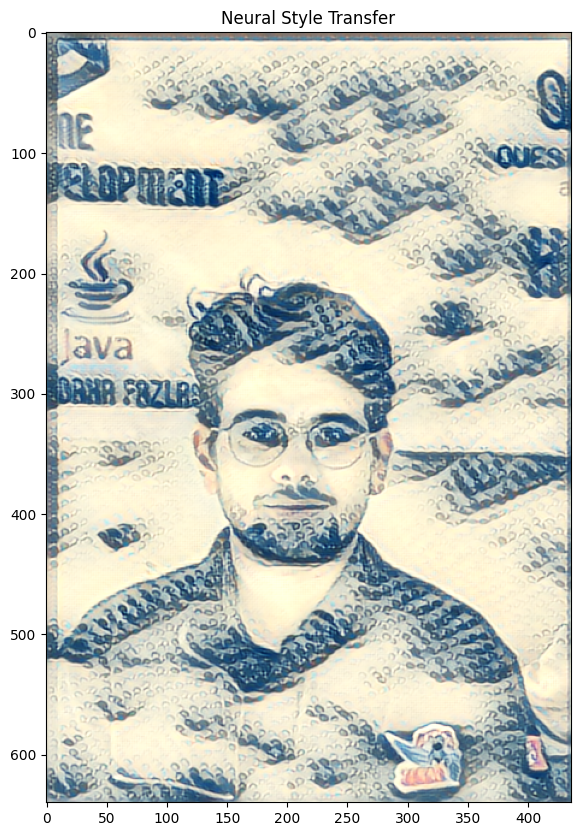

9. Using Model: udnie


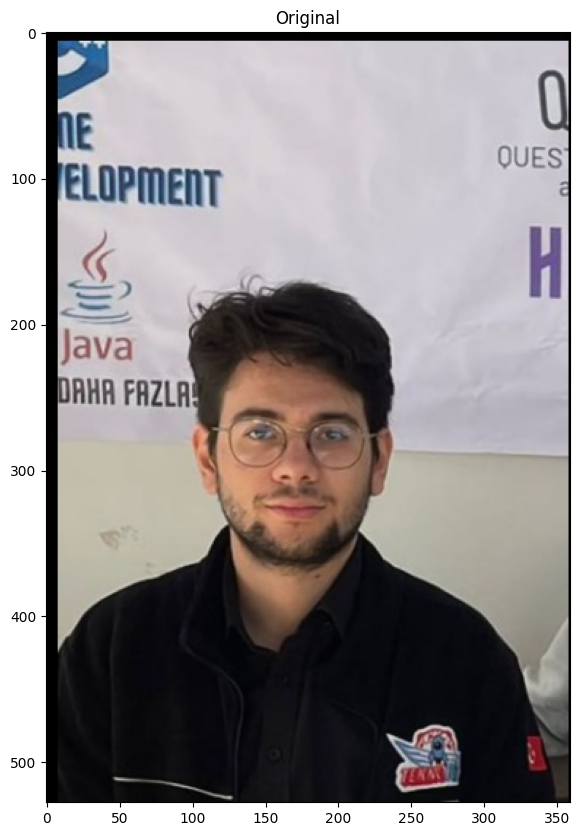

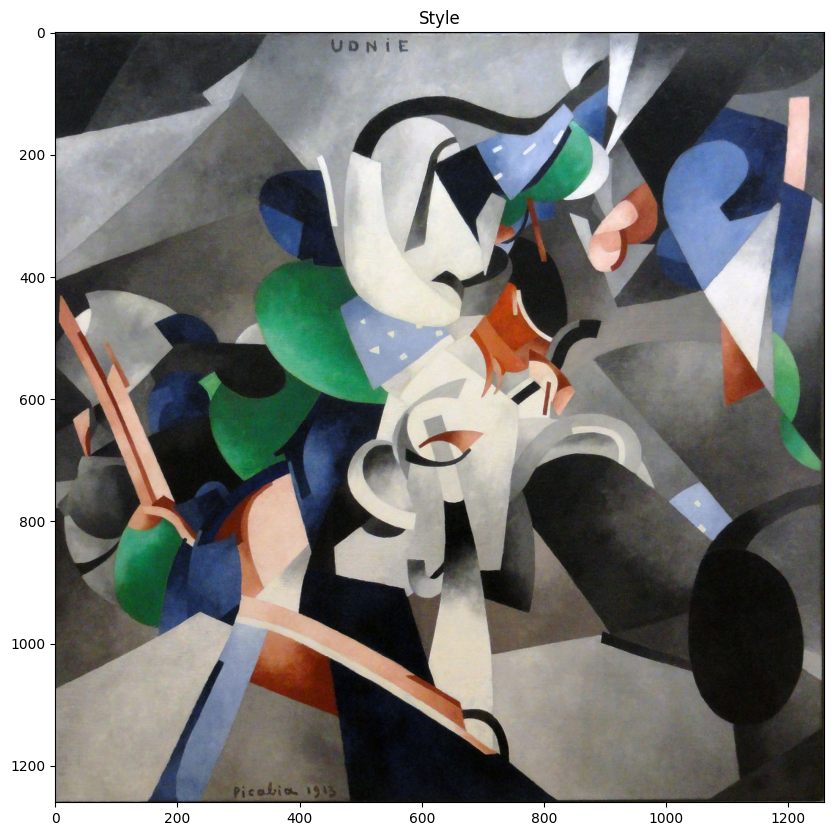

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


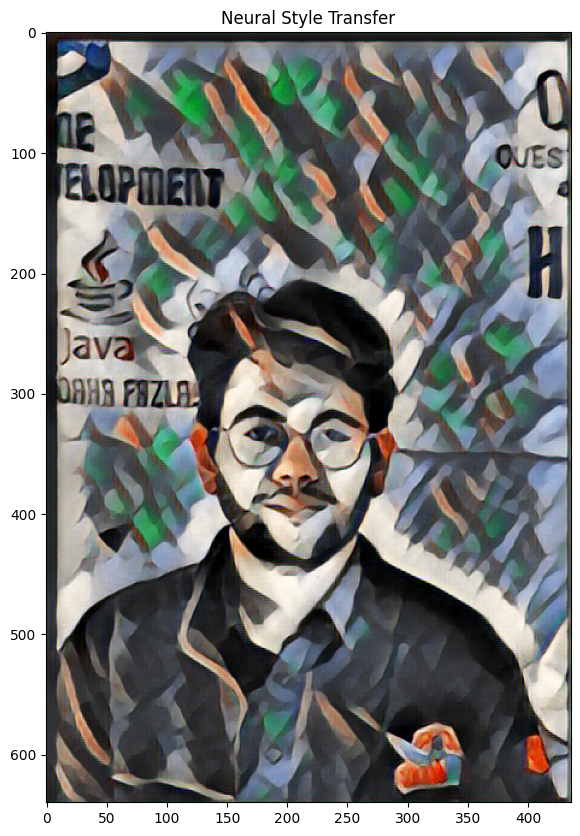

In [19]:

# Load our t7 neural transfer models
model_file_path = r"C:\Users\cengh\Desktop\dataset\NeuralStyleTransfer\models"
model_file_paths = [f for f in os.listdir(model_file_path) if os.path.isfile(os.path.join(model_file_path, f))]

# Load our test image
img_path = r"C:\Users\cengh\Desktop\ComputerVison\HaarCascade\CengizhanBayram.jpeg"
img = cv2.imread(img_path)

# Check if the image was loaded properly
if img is None:
    print(f"Error: Could not load image {img_path}.")
else:
    # Loop through and apply each model style to our input image
    for (i, model) in enumerate(model_file_paths):
        # Print the model being used
        print(str(i + 1) + ". Using Model: " + str(model)[:-3])    
        style_path = os.path.join(r"C:\Users\cengh\Desktop\dataset\NeuralStyleTransfer\art", str(model)[:-3] + ".jpg")
        style = cv2.imread(style_path)

        # Check if the style image was loaded properly
        if style is None:
            print(f"Error: Could not load style image {style_path}")
            continue

        # Load the neural style transfer model
        neuralStyleModel = cv2.dnn.readNetFromTorch(os.path.join(model_file_path, model))

        # Resize the image to a fixed height of 640 (feel free to change)
        height, width = img.shape[:2]
        newWidth = int((640 / height) * width)
        resizedImg = cv2.resize(img, (newWidth, 640), interpolation=cv2.INTER_AREA)

        # Create our blob from the image and then perform a forward pass run of the network
        inpBlob = cv2.dnn.blobFromImage(resizedImg, 1.0, (newWidth, 640), (103.939, 116.779, 123.68), swapRB=False, crop=False)

        neuralStyleModel.setInput(inpBlob)
        output = neuralStyleModel.forward()

        # Reshape the output tensor, add back the mean subtraction, and re-order the channels 
        output = output.reshape((3, output.shape[2], output.shape[3]))
        output[0] += 103.939
        output[1] += 116.779
        output[2] += 123.68
        output /= 255.0
        output = output.transpose(1, 2, 0)

        # Display our original image, the style being applied, and the final Neural Style Transfer
        imshow("Original", img)
        imshow("Style", style)
        imshow("Neural Style Transfer", output)
        #   Cengizhan BAYRAM 
